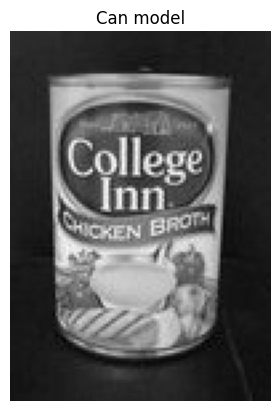

In [1]:
import os
import re
import numpy as np
from skimage import io
from skimage import color
from skimage import filters
from skimage import feature
from scipy.ndimage import maximum_filter
import cv2
from matplotlib import pyplot as plt
from scipy.spatial.distance import cdist
import pandas as pd

plt.axis("off")
can_img = io.imread("imgs/can/can_model.jpg")
can_img = color.rgb2gray(can_img)
plt.title("Can model")
plt.imshow(can_img, cmap="gray")


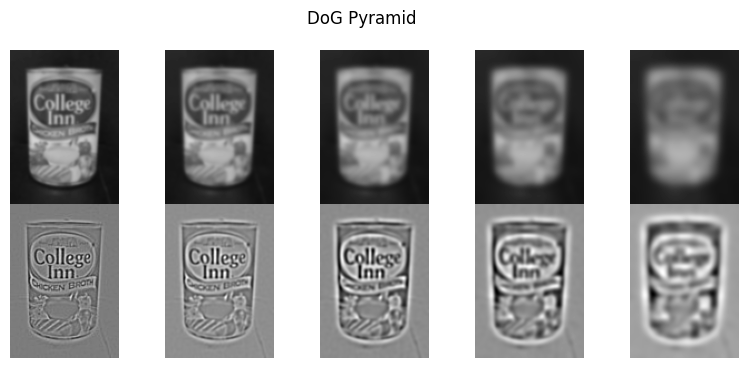

In [2]:
def createPyramid(img: np.ndarray, sigma0: float, k: float, numLevels: int)->tuple[np.ndarray, list]:
    """
    Creates Gaussian pyramid and DoG pyramid.

    Parameters
    ----------
    img : np.ndarray
        Input image.
    sigma0 : float
        Gaussian filter variance for the first level.
    k : float
        Multiplicative increase in scale for next pyramid level.
    numLevels : int
        Number of levels for the pyramid.
        
    Returns
    -------
    tuple[np.ndarray, list]
        Gaussian pyramid and DoG pyramid.
    """
    GaussianPyramid = []
    for i in range(-1, numLevels):
        GaussianPyramid.append(
            filters.gaussian(img, sigma=k**i * sigma0, mode="reflect")
        )
    DoGPyramid = list(np.diff(GaussianPyramid, n=1, axis=0))
    return GaussianPyramid[1:], DoGPyramid


sigma0 = 1
k = np.sqrt(2)
numLevels = 5
GaussianPyramid, DoGPyramid = createPyramid(can_img, sigma0, k, numLevels)
n = len(GaussianPyramid)
fig, axes = plt.subplots(2, n, figsize=(10, 4))

fig.subplots_adjust(wspace=0, hspace=0)
fig.suptitle("DoG Pyramid")
for i, (ax_up, ax_down) in enumerate(zip(*axes)):
    ax_up.imshow(GaussianPyramid[i], cmap="gray", vmin=0, vmax=1)
    ax_up.set_axis_off()
    ax_up.set_aspect("equal")

    ax_down.imshow(DoGPyramid[i], cmap="gray")
    ax_down.set_axis_off()
    ax_down.set_aspect("equal")


Text(0.5, 1.0, 'Local maximum, nonuniform and not an edge')

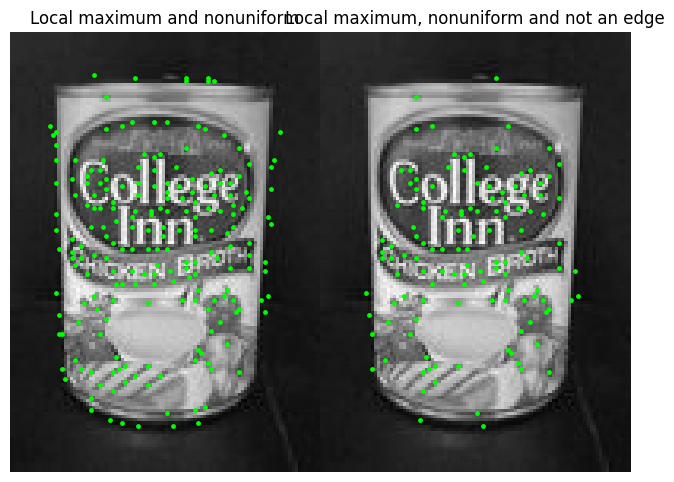

In [3]:
def detectDoGFeatures(DoGPyramid: list, uniformTh: float, edgeThr: float)->list:
    """
    Detects key feature points in DoGPyramid.

    Parameters
    ----------
    DoGPyramid : list
        List of different levels of DoG.
    uniformTh : float
        Threshold for uniform background points. 
    edgeThr : float
        Threshold for Hessian based edge points. 

    Returns
    -------
    list
        List of features (x, y, scale).
    """
    DoGPyramid = np.array(DoGPyramid)
    localPeaks = (
        maximum_filter(DoGPyramid, footprint=np.ones((3, 3, 3)), mode="nearest")
        == DoGPyramid
    )
    notUniform = np.abs(DoGPyramid) > uniformTh
    candidates = np.logical_and(localPeaks, notUniform)
    featureLocations = []
    for scale, y, x in zip(*np.nonzero(candidates)):
        if (
            x < 2
            or x > DoGPyramid.shape[2] - 3
            or y < 2
            or y > DoGPyramid.shape[1] - 3
        ):
            continue
        localNeighborhood = DoGPyramid[scale, y - 2 : y + 3, x - 2 : x + 3]
        Dx = (localNeighborhood[1:-1, 2:] - localNeighborhood[1:-1, :-2]) / 2
        Dy = (localNeighborhood[2:, 1:-1] - localNeighborhood[:-2, 1:-1]) / 2
        Dxx = (Dx[1, 2] - Dx[1, 0]) / 2
        Dyx = (Dx[2, 1] - Dx[0, 1]) / 2
        Dyy = (Dy[2, 1] - Dy[0, 1]) / 2
        Dxy = (Dy[1, 2] - Dy[1, 0]) / 2
        detH = Dxx * Dyy - Dxy * Dyx
        traceH = Dxx + Dyy
        ratio = traceH * traceH / detH
        if ratio < edgeThr:
            featureLocations.append((x, y, scale))
    return featureLocations


uniformTh = 0.03
edgeThr = 12
localPeaks = (
    maximum_filter(
        np.array(DoGPyramid), footprint=np.ones((3, 3, 3)), mode="nearest"
    )
    == DoGPyramid
)
notUniform = np.abs(DoGPyramid) > uniformTh
candidates = np.logical_and(localPeaks, notUniform)
candidates = np.transpose(np.transpose(candidates).nonzero())
featureLocations = detectDoGFeatures(DoGPyramid, uniformTh, edgeThr)
fig, axes = plt.subplots(1, 2, figsize=(8, 14))
fig.subplots_adjust(wspace=0, hspace=0)

axes[0].imshow(can_img, cmap="gray")
axes[0].scatter(
    np.array(candidates)[:, 0], np.array(candidates)[:, 1], c="lime", s=6
)
axes[0].set_axis_off()
axes[0].set_aspect("equal")
axes[0].set_title("Local maximum and nonuniform")
axes[1].imshow(can_img, cmap="gray")
axes[1].scatter(
    np.array(featureLocations)[:, 0],
    np.array(featureLocations)[:, 1],
    c="lime",
    s=6,
)
axes[1].set_axis_off()
axes[1].set_aspect("equal")
axes[1].set_title("Local maximum, nonuniform and not an edge");


Text(0.5, 1.0, 'BRIEF pairs, patch size: (9,9)')

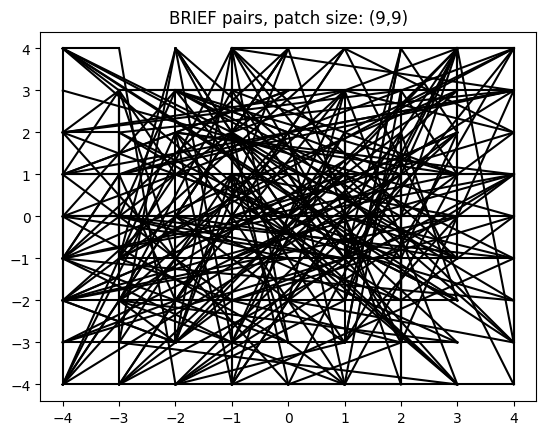

In [4]:
def generateBRIEFpattern(patchSize: int, testNum: int)->tuple[np.ndarray, np.ndarray]:
    """
    Generates BRIEF pattern size patchSize for testNum pair of points. 

    Parameters
    ----------
    patchSize : int
        Size of local region.
    testNum : int
        Number of pair points.

    Returns
    -------
    tuple[np.ndarray, np.ndarray]
        Tuple of first and second points, length testNum.
    """
    np.random.seed(1)
    p1Coords = np.random.rand(testNum, 2) * patchSize - (patchSize / 2)
    p1Coords = np.round(p1Coords).astype(np.intp)
    np.random.seed(2)
    p2Coords = np.random.rand(testNum, 2) * patchSize - (patchSize / 2)
    p2Coords = np.round(p2Coords).astype(np.intp)
    return p1Coords, p2Coords


patchSize = 9
testNum = 256
p1Coords, p2Coords = generateBRIEFpattern(patchSize, testNum)
for p1, p2 in zip(p1Coords, p2Coords):
    plt.plot(*zip(p1, p2), c="k")
plt.title(f"BRIEF pairs, patch size: ({patchSize},{patchSize})");


In [5]:
def computePyrBRIEF(GaussianPyramid:np.ndarray, featureLocations:list, k: float, patchSize: int, p1Coords: np.ndarray, p2Coords: np.ndarray)-> tuple[np.ndarray,np.ndarray]:
    """
    Computes descriptions of featureLocations that not outside of image boundary.

    Parameters
    ----------
    GaussianPyramid : np.ndarray
        Gaussian pyramid.
    featureLocations : list
        Position of located key features.
    k : float
        Multiplicative increase in scale for next pyramid level.
    patchSize : int
        Local Region used for p1Coords and p2Coords.
    p1Coords : np.ndarray
        First point in BRIEF pair.
    p2Coords : np.ndarray
        Second point in BRIEF pair.

    Returns
    -------
    tuple[np.ndarray,np.ndarray]
        Description of key feature and there respective location.
    """


    descBRIEF = []
    locBRIEF = []
    imgHeight, imgWidth = GaussianPyramid[0].shape
    for x, y, scale in featureLocations:
        regionSize = patchSize * k**scale
        borderWidth = regionSize // 2
        if (
            x < borderWidth
            or x > imgWidth - (borderWidth + 1)
            or y < borderWidth
            or y > imgHeight - (borderWidth + 1)
        ):
            continue
        img = GaussianPyramid[scale]
        p1RelativeCords = (
            np.round(p1Coords / patchSize * regionSize).astype(np.intp)
            + np.c_[x, y]
        ).T
        p2RelativeCords = (
            np.round(p2Coords / patchSize * regionSize).astype(np.intp)
            + np.c_[x, y]
        ).T
        p1 = img[p1RelativeCords[1], p1RelativeCords[0]]
        p2 = img[p2RelativeCords[1], p2RelativeCords[0]]
        descBRIEF.append(p1 > p2)
        locBRIEF.append((x, y, scale))
    descBRIEF = np.array(descBRIEF).T
    locBRIEF = np.array(locBRIEF).T
    return descBRIEF, locBRIEF


descBRIEFCan1, locBRIEFCan1 = computePyrBRIEF(
    GaussianPyramid, featureLocations, k, patchSize, p1Coords, p2Coords
)


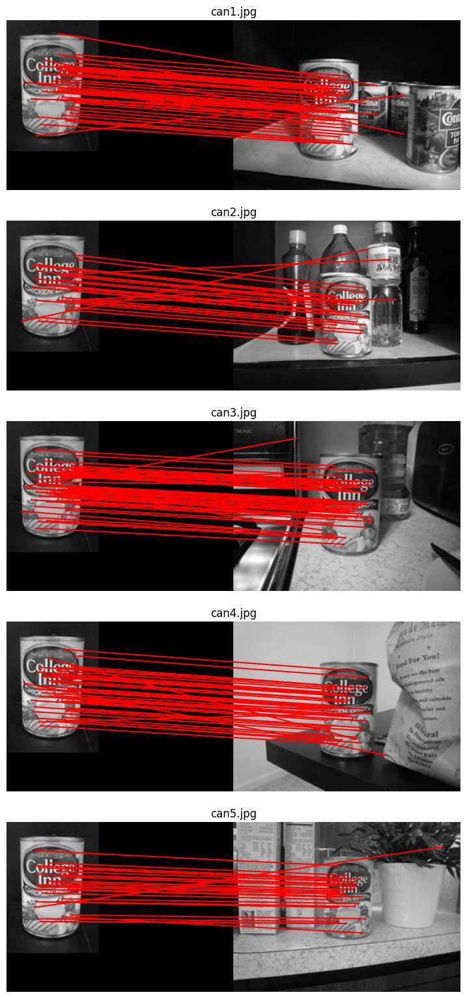

In [6]:
def ratioTest(ratioThr: float, distances: np.ndarray, indices1: np.ndarray, indices2: np.ndarray)-> np.ndarray:
    """
    Gives mask of indices of points that pass the ratio (distance of best and second best). 

    Parameters
    ----------
    ratioThr : float
        Threshold used for ratio test.
    distances : np.ndarray
        Distance matrix.
    indices1 : np.ndarray
        Indices of first image for matching.
    indices2 : np.ndarray
        Indices of second image for matching.

    Returns
    -------
    np.ndarray
        Mask of indices that pass the ratio test.
    """
    distances = distances.copy()
    best_distances = distances[indices1, indices2]
    distances[indices1, indices2] = np.inf
    second_best_indices2 = np.argmin(distances[indices1], axis=1)
    second_best_distances = distances[indices1, second_best_indices2]
    second_best_distances[second_best_distances == 0] = np.finfo(np.float64).eps
    ratio = best_distances / second_best_distances
    mask = ratio < ratioThr
    return mask


def matchBRIEF(
    descriptor1: np.ndarray, location1: np.ndarray, descriptor2: np.ndarray, location2: np.ndarray, ratioThr: float, crossCheck:bool
)->np.ndarray:
    """
    Matches the most similar descriptors from two different images.
    
    Additionally filters the descriptors using cross check (optional) and ratio test. 

    Parameters
    ----------
    descriptor1 : np.ndarray
        Descriptors from the first image.
    location1 : np.ndarray
        Locations of descriptors from the first image.
    descriptor2 : np.ndarray
        Descriptors from the the second image.
    location2 : np.ndarray
        Locations of descriptors from the second image.
    ratioThr : float
        Ratio test threshold.
    crossCheck : bool
        Cross check boolean.

    Returns
    -------
    np.ndarray
        Pair of most similar features.
    """
    descriptor1 = descriptor1.T
    descriptor2 = descriptor2.T
    distances = cdist(
        descriptor1,
        descriptor2,
        metric="hamming",
    )

    indices1 = np.arange(descriptor1.shape[0])

    indices2 = np.argmin(distances, axis=1)

    mask = ratioTest(ratioThr, distances, indices1, indices2)
    indices1 = indices1[mask]
    indices2 = indices2[mask]
    matches12 = np.column_stack((indices1, indices2))
    if crossCheck:
        indices1 = np.argmin(distances, axis=0)
        indices2 = np.arange(descriptor2.shape[0])
        mask = ratioTest(ratioThr, distances, indices1, indices2)
        indices1 = indices1[mask]
        indices2 = indices2[mask]
        matches21 = np.column_stack((indices1, indices2))
        matches = np.vstack((matches12, matches21))
        points, count = np.unique(matches, return_counts=True, axis=0)
        matches = points[count == 2]
    else:
        matches = matches12
    return matches


def matchImagesBRIEF(img1: np.ndarray, img2: np.ndarray)->tuple():
    GaussianPyramid1, DoGPyramid1 = createPyramid(img1, sigma0, k, numLevels)
    featureLocations1 = detectDoGFeatures(DoGPyramid1, uniformTh, edgeThr)
    descBRIEF1, locBRIEF1 = computePyrBRIEF(
        GaussianPyramid1, featureLocations1, k, patchSize, p1Coords, p2Coords
    )
    GaussianPyramid2, DoGPyramid2 = createPyramid(img2, sigma0, k, numLevels)
    featureLocations2 = detectDoGFeatures(DoGPyramid2, uniformTh, edgeThr)
    descBRIEF2, locBRIEF2 = computePyrBRIEF(
        GaussianPyramid2, featureLocations2, k, patchSize, p1Coords, p2Coords
    )
    matches = matchBRIEF(
        descBRIEF1, locBRIEF1, descBRIEF2, locBRIEF2, ratioThr, crossCheck=True
    )
    return locBRIEF1, locBRIEF2, matches


p1Coords, p2Coords = generateBRIEFpattern(patchSize, testNum)
ratioThr = 0.8
paths = os.listdir("imgs/can")
fig, axes = plt.subplots(len(paths) - 1, figsize=(9, 20))
fig.subplots_adjust(wspace=0, hspace=0)
imgCan1 = io.imread("imgs/can/can_model.jpg")
imgCan1 = color.rgb2gray(imgCan1)
for canFile, ax in zip(paths, axes):
    if canFile == "can_model.jpg":
        continue
    ax.set_axis_off()
    ax.set_aspect("equal")
    canPath = os.path.join("imgs/can", canFile)
    imgCan2 = io.imread(canPath)
    imgCan2 = color.rgb2gray(imgCan2)
    locBRIEFCan1, locBRIEFCan2, matches = matchImagesBRIEF(imgCan1, imgCan2)
    ax.set_title(canFile)
    feature.plot_matches(
        ax,
        imgCan1,
        imgCan2,
        locBRIEFCan1[[1, 0]].T,
        locBRIEFCan2[[1, 0]].T,
        matches,
        only_matches=True,
        matches_color="red",
    )


In [7]:
imgCan = io.imread("imgs/can/can_model.jpg")
imgCan = color.rgb2gray(imgCan)


def compareAfterTransformation(
    img, parameter_span, parameter_name, transformation, match_function
):
    results = {
        parameter_name: parameter_span,
        "good matches": [],
        "number of matches": [],
        "ratio": [],
    }
    for parameter in parameter_span:
        fig = plt.figure(figsize=(6, 14))
        fig.subplots_adjust(wspace=0, hspace=0)
        ax = plt.gca()
        ax.set_axis_off()
        ax.set_aspect("equal")
        ax.set_title(f"{parameter_name}: {parameter}")
        M, transformedImg = transformation(parameter, img)
        locBRIEF, locBRIEFTransformed, matches = match_function(
            img, transformedImg
        )
        locs = locBRIEF[:2].T[matches[:, 0]]
        locsTransformed = np.c_[locs, np.ones(len(locs))] @ M.T
        if locsTransformed.shape[1] == 3:
            locsTransformed = (
                locsTransformed[:, :2] / locsTransformed[:, 2][:, np.newaxis]
            )
        locsMatched = locBRIEFTransformed[:2].T[matches[:, 1]]
        a, b = (locsTransformed - locsMatched).T
        goodMatch = np.hypot(a, b) <= 3
        results["good matches"].append(goodMatch.sum())
        results["number of matches"].append(len(goodMatch))
        results["ratio"].append(goodMatch.sum() / len(goodMatch))
        feature.plot_matches(
            ax,
            can_img,
            transformedImg,
            locBRIEF[[1, 0]].T,
            locBRIEFTransformed[[1, 0]].T,
            matches,
            only_matches=True,
            matches_color="red",
        )
    if len(parameter_span):
        df = pd.DataFrame(results)
        df["ratio"] = df["ratio"].map(lambda x: f"{x:.2%}")
        display(
            df.style.format_index(str.upper, axis=1).format(precision=2).hide()
        )


ROTATION,GOOD MATCHES,NUMBER OF MATCHES,RATIO
5,46,50,92.00%
10,55,59,93.22%
20,11,15,73.33%
40,0,8,0.00%
80,0,6,0.00%
120,0,9,0.00%


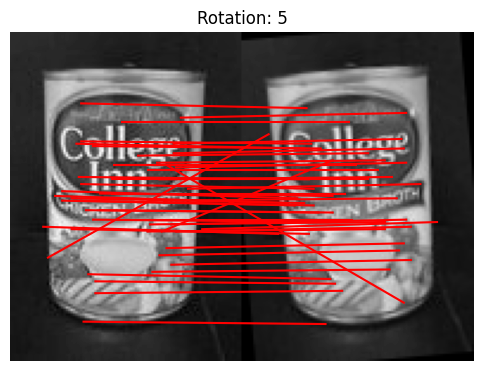

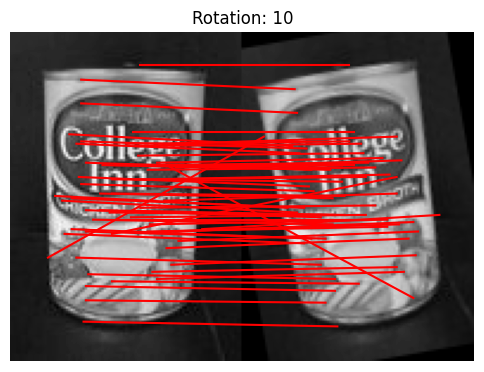

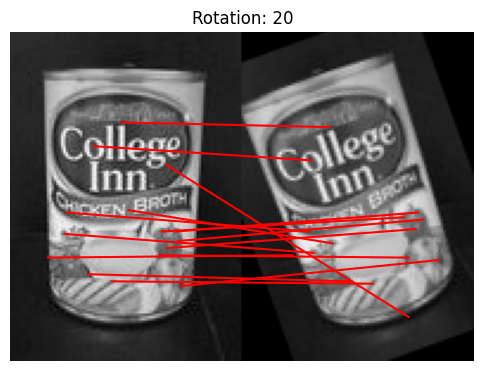

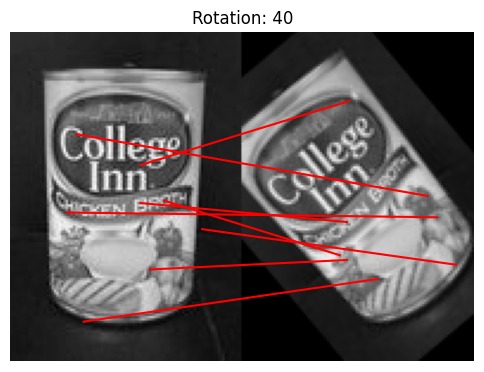

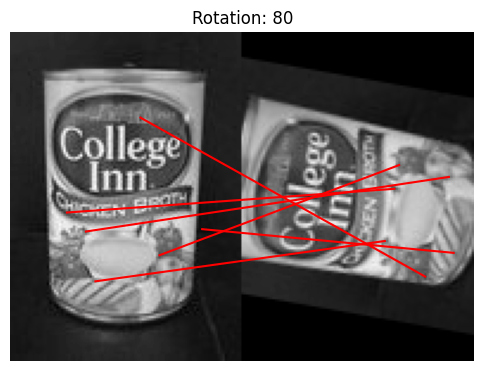

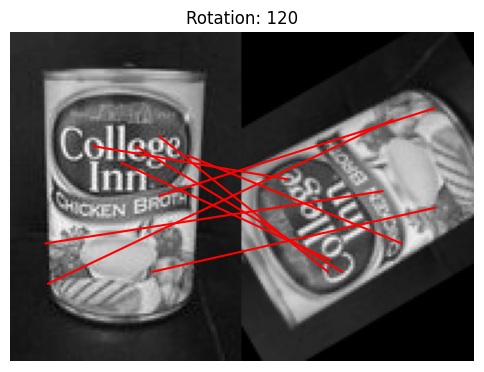

In [8]:
parameter_span = [5, 10, 20, 40, 80, 120]
parameter_name = "Rotation"


def rotation(angle, img):
    rows, cols = can_img.shape
    M = cv2.getRotationMatrix2D(((cols - 1) / 2.0, (rows - 1) / 2.0), angle, 1)
    return M, cv2.warpAffine(img, M, (cols, rows))


compareAfterTransformation(
    imgCan, parameter_span, parameter_name, rotation, matchImagesBRIEF
)


SCALE,GOOD MATCHES,NUMBER OF MATCHES,RATIO
0.50,18,23,78.26%
2.00,55,59,93.22%
4.00,24,39,61.54%


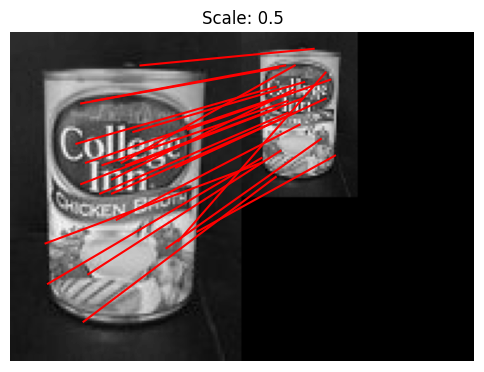

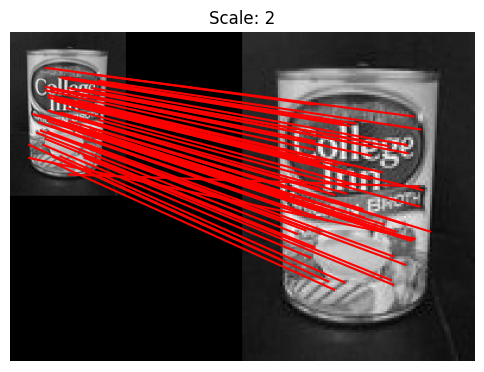

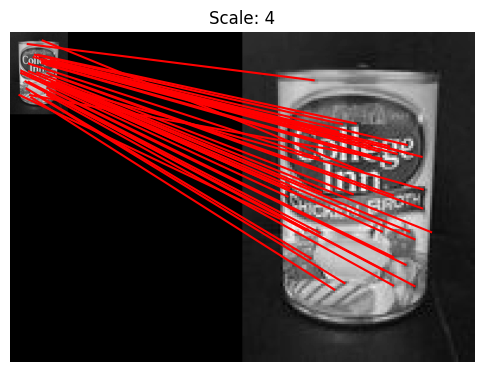

In [9]:
parameter_span = [0.5, 2, 4]
parameter_name = "Scale"


def scale(scale, img):
    M = np.array([[scale, 0, 0], [0, scale, 0]], np.float64)
    return M, cv2.resize(
        img, None, fx=scale, fy=scale, interpolation=cv2.INTER_NEAREST
    )


compareAfterTransformation(
    imgCan, parameter_span, parameter_name, scale, matchImagesBRIEF
)


SHEER,GOOD MATCHES,NUMBER OF MATCHES,RATIO
0.05,59,62,95.16%
0.10,54,61,88.52%
0.20,34,38,89.47%
0.40,7,12,58.33%


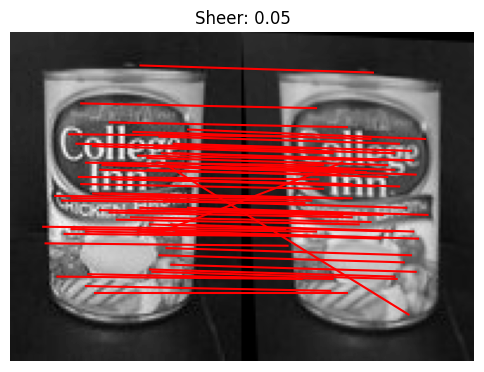

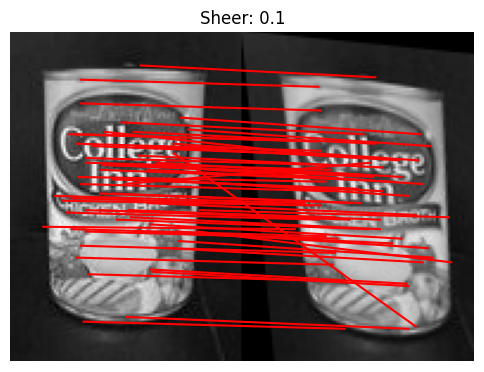

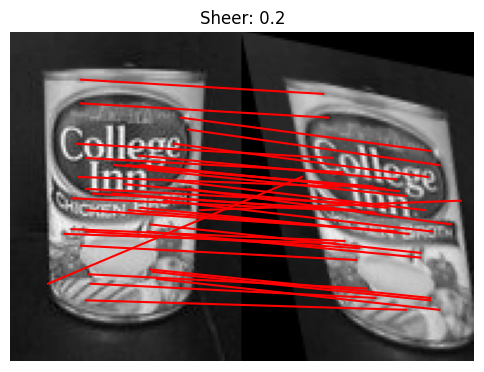

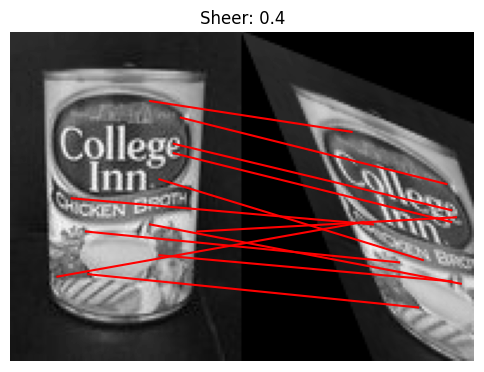

In [10]:
parameter_span = [0.05, 0.1, 0.2, 0.4]
parameter_name = "Sheer"


def sheer(factor, img):
    rows, cols = can_img.shape
    M = np.array([[1, factor, 0], [factor, 1, 0]], np.float64)
    return M, cv2.warpAffine(img, M, (cols, rows))


compareAfterTransformation(
    imgCan, parameter_span, parameter_name, sheer, matchImagesBRIEF
)


HOMOGRAPHY,GOOD MATCHES,NUMBER OF MATCHES,RATIO
1,14,17,82.35%


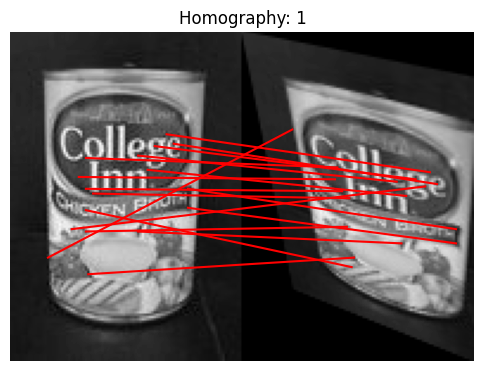

In [11]:
parameter_span = [1]
parameter_name = "Homography"


def homography(parameter, img):
    rows, cols = can_img.shape
    M = np.array([[1, 0.2, 0], [0.2, 1, 0], [-0.002, 0.002, 1]], np.float64)
    return M, cv2.warpPerspective(img, M, (cols, rows))


compareAfterTransformation(
    imgCan, parameter_span, parameter_name, homography, matchImagesBRIEF
)


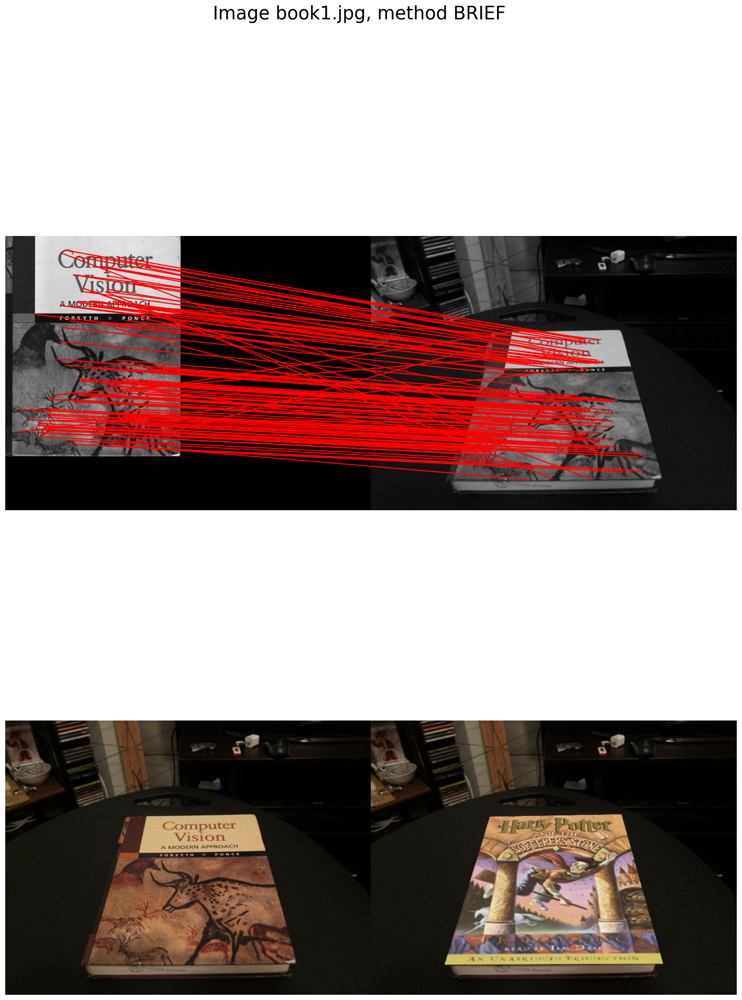

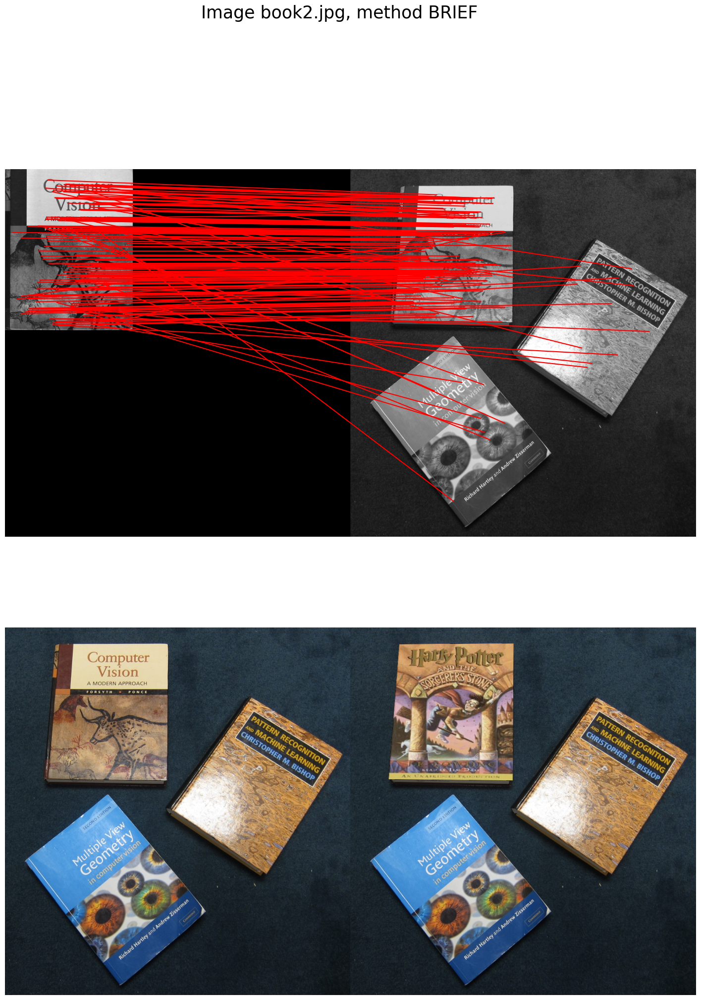

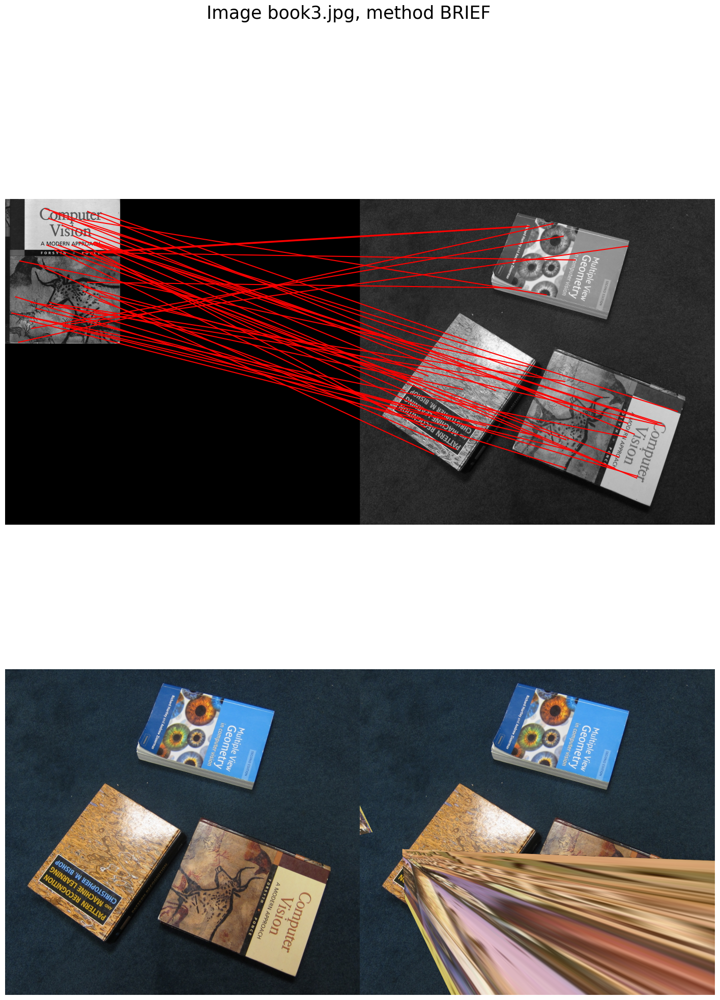

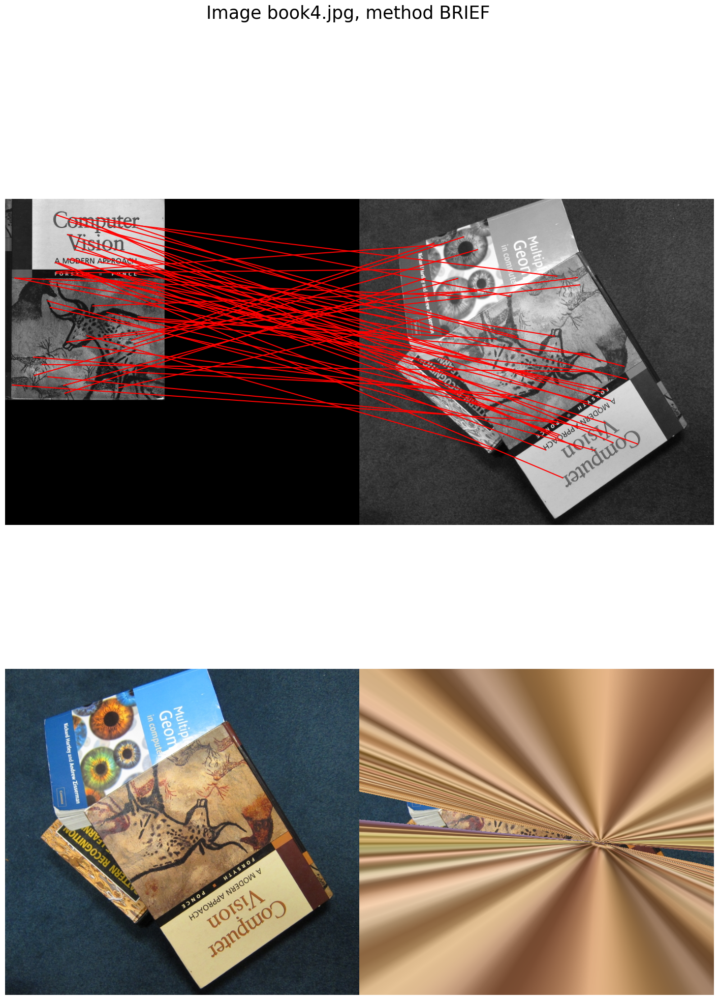

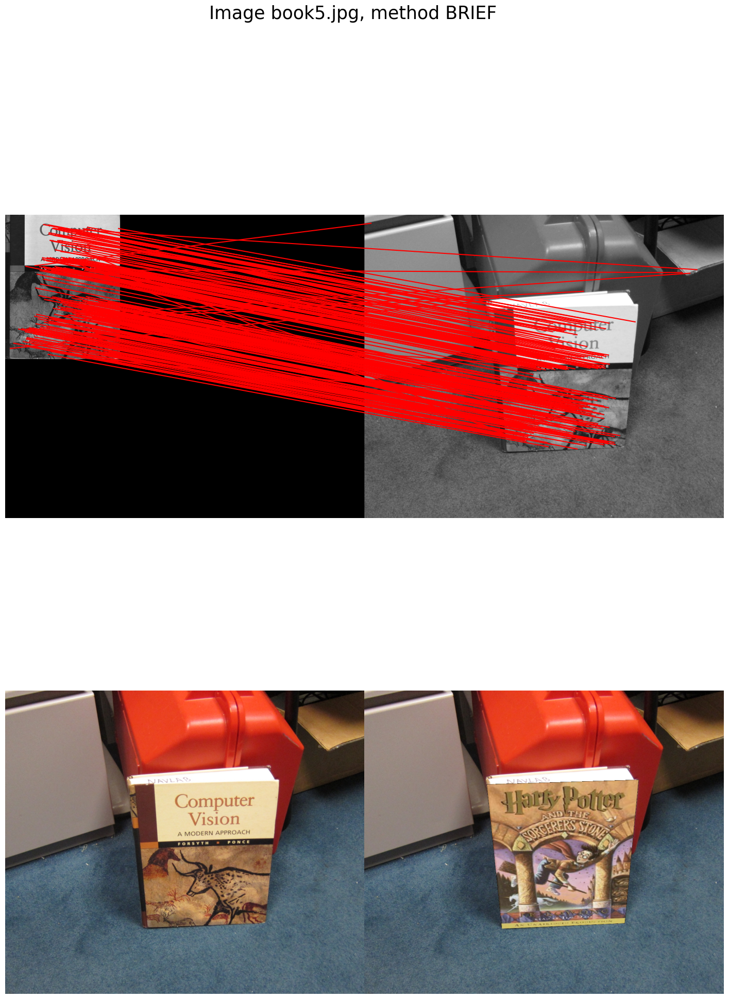

In [12]:
paths = os.listdir("imgs/book/")
paths = [
    re.fullmatch("book\d\.jpg", p).string
    for p in paths
    if re.fullmatch("book\d\.jpg", p)
]

imgBook1 = cv2.imread("imgs/book/book_model.jpg", cv2.IMREAD_GRAYSCALE)
imgHP = cv2.imread("imgs/book/hp_cover.jpg", cv2.IMREAD_COLOR)
imgHP = cv2.cvtColor(imgHP, cv2.COLOR_BGR2RGB)
imgHP = cv2.resize(imgHP, imgBook1.shape[::-1])

for bookFile in paths:
    fig = plt.figure(figsize=(18, 24))

    gs = fig.add_gridspec(2, 2)
    ax1 = fig.add_subplot(gs[0, :])
    ax2 = fig.add_subplot(gs[1, 0])
    ax3 = fig.add_subplot(gs[1, 1])
    fig.suptitle(f"Image {bookFile}, method BRIEF",size=25)
    fig.subplots_adjust(wspace=0, hspace=0)
    ax1.set_axis_off()
    ax1.set_aspect("equal")
    ax2.set_axis_off()
    ax2.set_aspect("equal")
    ax3.set_axis_off()
    ax3.set_aspect("equal")
    bookPath = os.path.join("imgs/book", bookFile)
    imgBook2 = cv2.imread(bookPath, cv2.IMREAD_GRAYSCALE)
    imgBook2Color = cv2.imread(bookPath, cv2.IMREAD_COLOR)
    imgBook2Color = cv2.cvtColor(imgBook2Color, cv2.COLOR_BGR2RGB)
    rows, cols = imgBook2.shape
    locBRIEFBook1, locBRIEFBook2, matches = matchImagesBRIEF(imgBook1, imgBook2)
    locs1 = locBRIEFBook1[:2, matches[:, 0]].T
    locs2 = locBRIEFBook2[:2, matches[:, 1]].T
    M, _ = cv2.findHomography(locs1, locs2, cv2.RANSAC)

    transformedBook = cv2.warpPerspective(imgHP, M, (cols, rows))
    mask = transformedBook != 0
    newImg = imgBook2Color * np.logical_not(mask) + transformedBook * mask
    ax2.imshow(imgBook2Color, cmap="gray", interpolation=None)
    ax3.imshow(newImg, cmap="gray", interpolation=None)
    feature.plot_matches(
        ax1,
        imgBook1,
        imgBook2,
        locBRIEFBook1[[1, 0]].T,
        locBRIEFBook2[[1, 0]].T,
        matches,
        only_matches=True,
        matches_color="red",
    )


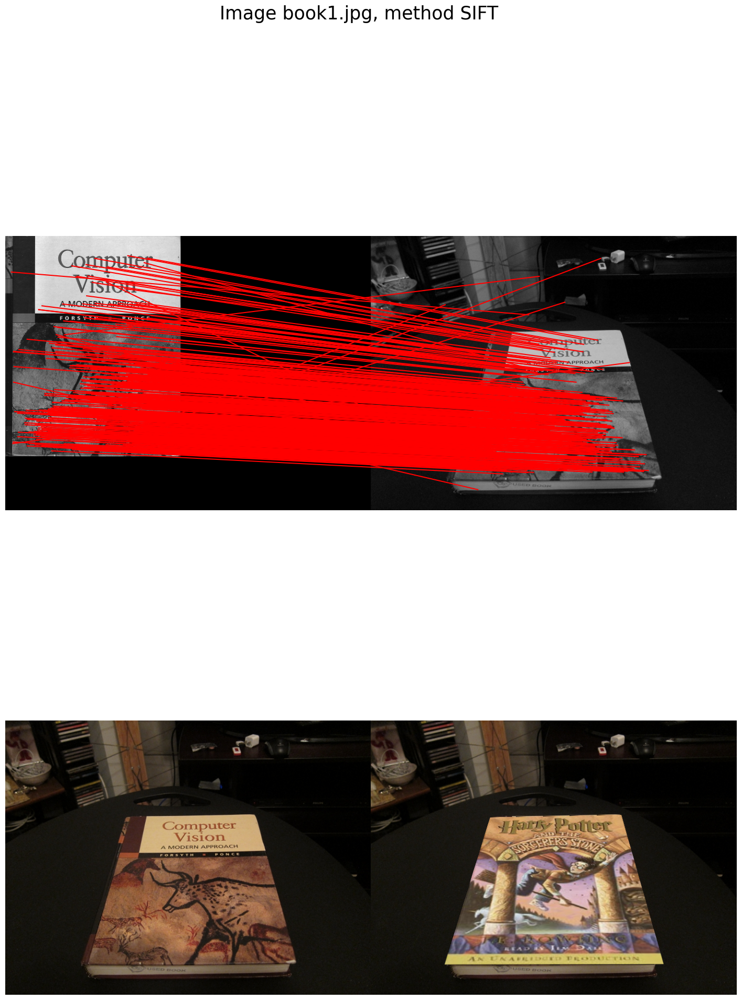

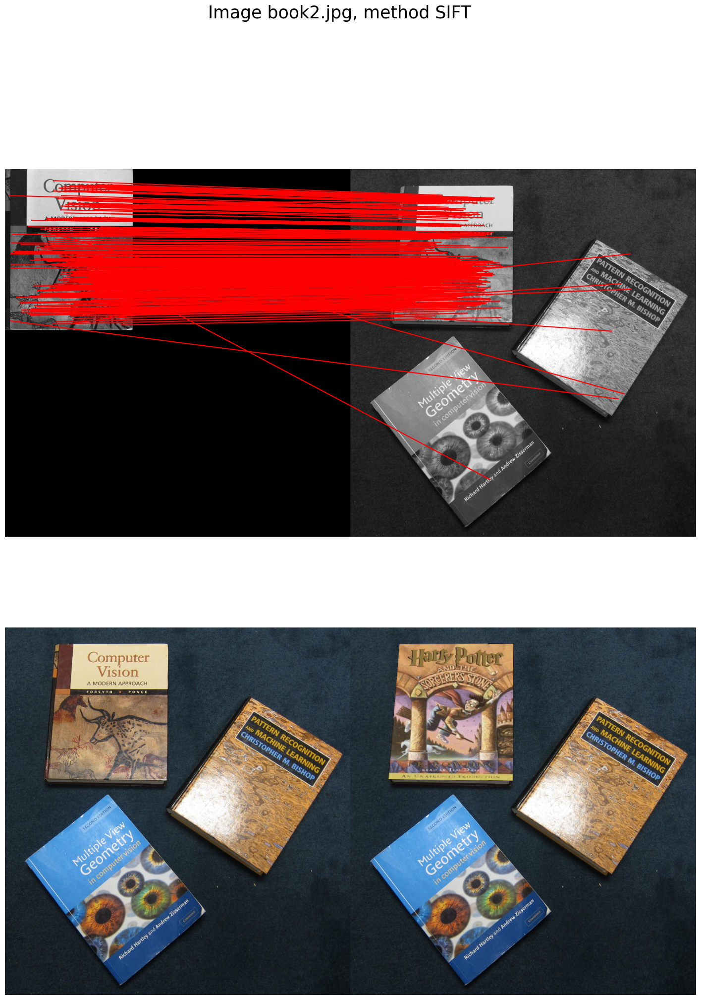

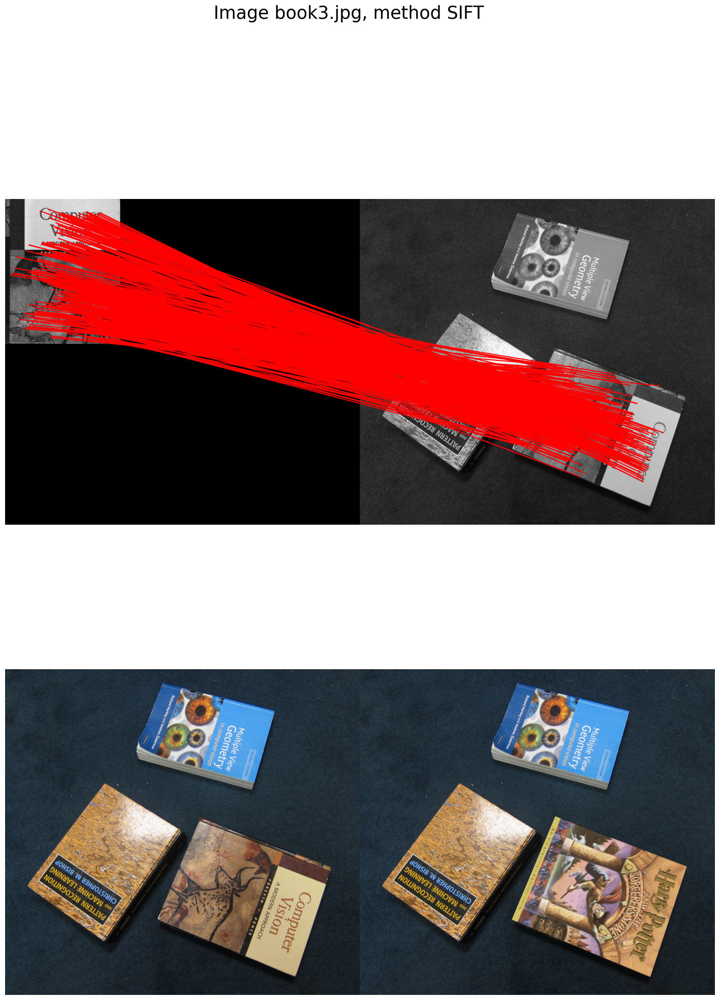

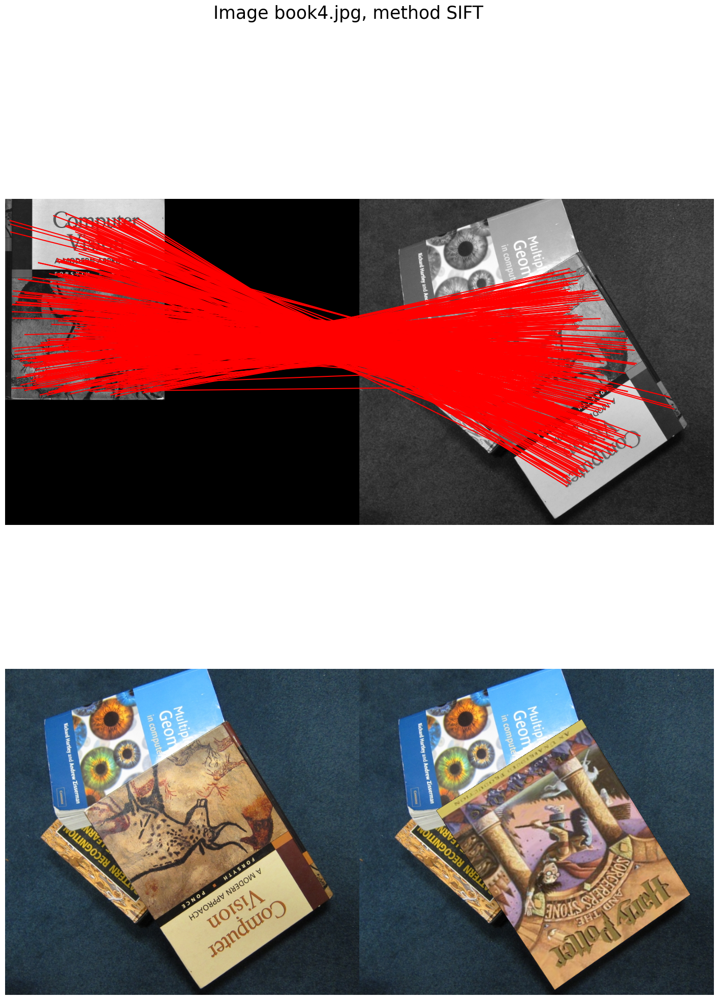

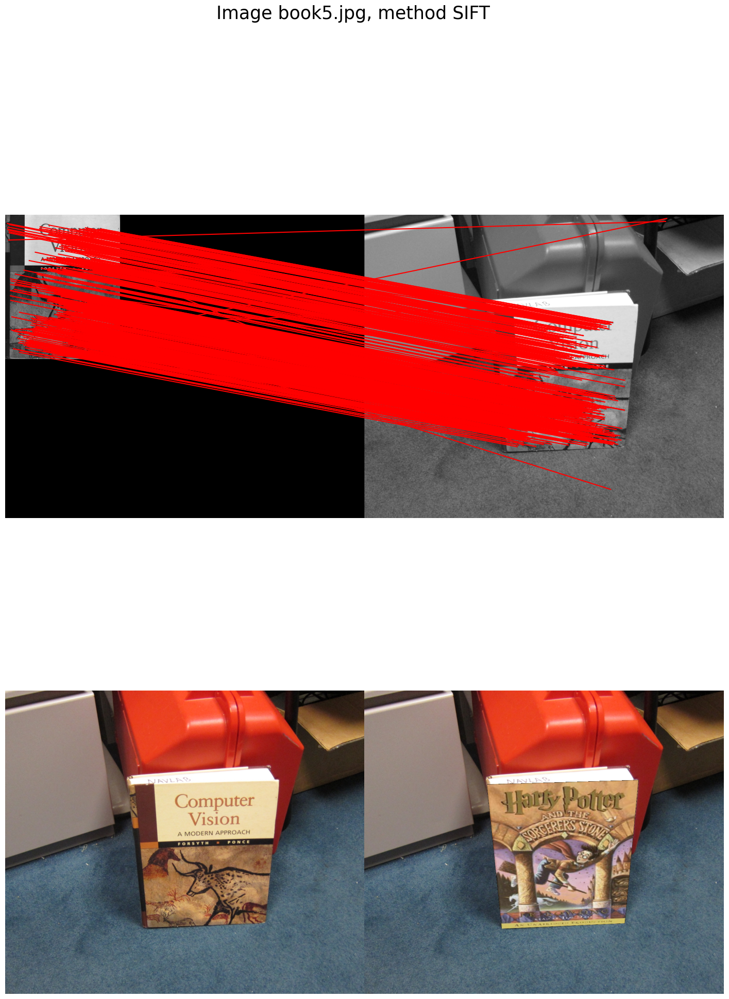

In [13]:
def matchImagesSIFT(img1, img2):
    sift = cv2.SIFT_create()

    # find the keypoints and descriptors with SIFT
    locSIFTBook1, descSIFT1 = sift.detectAndCompute(img1, None)
    locSIFTBook2, descSIFT2 = sift.detectAndCompute(img2, None)
    locSIFTBook1 = np.array([p.pt for p in locSIFTBook1]).T
    locSIFTBook2 = np.array([p.pt for p in locSIFTBook2]).T
    bf = cv2.BFMatcher(cv2.NORM_L2)
    matches = bf.knnMatch(descSIFT1, descSIFT2, k=2)
    # Apply ratio test
    good_matches = []
    for m, n in matches:
        if m.distance < 0.8 * n.distance:
            good_matches.append(m)
    matches = np.array([(m.queryIdx, m.trainIdx) for m in good_matches])
    return locSIFTBook1, locSIFTBook2, matches


for bookFile in paths:
    fig = plt.figure(figsize=(18, 24))

    gs = fig.add_gridspec(2, 2)
    ax1 = fig.add_subplot(gs[0, :])
    ax2 = fig.add_subplot(gs[1, 0])
    ax3 = fig.add_subplot(gs[1, 1])
    fig.suptitle(f"Image {bookFile}, method SIFT",size=25)
    fig.subplots_adjust(wspace=0, hspace=0)
    ax1.set_axis_off()
    ax1.set_aspect("equal")
    ax2.set_axis_off()
    ax2.set_aspect("equal")
    ax3.set_axis_off()
    ax3.set_aspect("equal")
    bookPath = os.path.join("imgs/book", bookFile)
    imgBook2 = cv2.imread(bookPath, cv2.IMREAD_GRAYSCALE)
    imgBook2Color = cv2.imread(bookPath, cv2.IMREAD_COLOR)
    imgBook2Color = cv2.cvtColor(imgBook2Color, cv2.COLOR_BGR2RGB)
    rows, cols = imgBook2.shape
    locBRIEFBook1, locBRIEFBook2, matches = matchImagesSIFT(imgBook1, imgBook2)
    locs1 = locBRIEFBook1[:2, matches[:, 0]].T
    locs2 = locBRIEFBook2[:2, matches[:, 1]].T
    M, _ = cv2.findHomography(locs1, locs2, cv2.RANSAC)

    transformedBook = cv2.warpPerspective(imgHP, M, (cols, rows))
    mask = transformedBook != 0
    newImg = imgBook2Color * np.logical_not(mask) + transformedBook * mask
    ax2.imshow(imgBook2Color, cmap="gray", interpolation=None)
    ax3.imshow(newImg, cmap="gray", interpolation=None)
    feature.plot_matches(
        ax1,
        imgBook1,
        imgBook2,
        locBRIEFBook1[[1, 0]].T,
        locBRIEFBook2[[1, 0]].T,
        matches,
        only_matches=True,
        matches_color="red",
    )


In [14]:
def detectDoGFeatures2(DoGPyramid, uniformTh, edgeThr):
    DoGPyramid = np.array(DoGPyramid)
    localPeaks = (
        maximum_filter(DoGPyramid, footprint=np.ones((3, 3, 3)), mode="nearest")
        == DoGPyramid
    )
    notUniform = np.abs(DoGPyramid) > uniformTh
    candidates = np.logical_and(localPeaks, notUniform)
    featureLocations = []
    for scale, y, x in zip(*np.nonzero(candidates)):
        if (
            x < 2
            or x > DoGPyramid.shape[2] - 3
            or y < 2
            or y > DoGPyramid.shape[1] - 3
        ):
            continue
        localNeighborhood = DoGPyramid[scale, y - 2 : y + 3, x - 2 : x + 3]
        Dx = (localNeighborhood[1:-1, 2:] - localNeighborhood[1:-1, :-2]) / 2
        Dy = (localNeighborhood[2:, 1:-1] - localNeighborhood[:-2, 1:-1]) / 2
        Dxx = (Dx[1, 2] - Dx[1, 0]) / 2
        Dyx = (Dx[2, 1] - Dx[0, 1]) / 2
        Dyy = (Dy[2, 1] - Dy[0, 1]) / 2
        Dxy = (Dy[1, 2] - Dy[1, 0]) / 2
        detH = Dxx * Dyy - Dxy * Dyx
        traceH = Dxx + Dyy
        ratio = traceH * traceH / detH
        if ratio < edgeThr:
            G = Dx**2 + Dy**2
            Gy, Gx = np.unravel_index(np.argmax(G), G.shape)
            theta = np.arctan2(Dy[Gy, Gx], Dx[Gy, Gx])
            featureLocations.append((x, y, scale, theta))
    return featureLocations


def computePyrBRIEF2(
    GaussianPyramid, featureLocations, k, patchSize, p1Coords, p2Coords
):
    descBRIEF = []
    locBRIEF = []
    imgHeight, imgWidth = GaussianPyramid[0].shape
    for x, y, scale, theta in featureLocations:
        regionSize = patchSize * k**scale
        borderWidth = regionSize // 2
        borderWidth += (
            np.abs((np.sin(theta) * np.sqrt(2) / 2 * borderWidth)).astype(
                np.intp
            )
            + 1
        )
        R = np.r_[
            [[np.cos(theta), -np.sin(theta)]], [[np.sin(theta), np.cos(theta)]]
        ]
        p1RelativeCords = (
            np.round(p1Coords @ R.T / patchSize * regionSize).astype(np.intp)
            + np.c_[x, y]
        ).T
        p2RelativeCords = (
            np.round(p2Coords @ R.T / patchSize * regionSize).astype(np.intp)
            + np.c_[x, y]
        ).T
        if (
            x < borderWidth
            or x > imgWidth - (borderWidth + 1)
            or y < borderWidth
            or y > imgHeight - (borderWidth + 1)
        ):
            continue
        img = GaussianPyramid[scale]

        p1 = img[p1RelativeCords[1], p1RelativeCords[0]]
        p2 = img[p2RelativeCords[1], p2RelativeCords[0]]
        descBRIEF.append(p1 > p2)
        locBRIEF.append((x, y, scale))
    descBRIEF = np.array(descBRIEF).T
    locBRIEF = np.array(locBRIEF).T
    return descBRIEF, locBRIEF


def matchImagesrBRIEF(img1, img2):
    GaussianPyramid1, DoGPyramid1 = createPyramid(img1, sigma0, k, numLevels)
    featureLocations1 = detectDoGFeatures2(DoGPyramid1, uniformTh, edgeThr)
    descBRIEF1, locBRIEF1 = computePyrBRIEF2(
        GaussianPyramid1, featureLocations1, k, patchSize, p1Coords, p2Coords
    )
    GaussianPyramid2, DoGPyramid2 = createPyramid(img2, sigma0, k, numLevels)
    featureLocations2 = detectDoGFeatures2(DoGPyramid2, uniformTh, edgeThr)
    descBRIEF2, locBRIEF2 = computePyrBRIEF2(
        GaussianPyramid2, featureLocations2, k, patchSize, p1Coords, p2Coords
    )
    matches = matchBRIEF(
        descBRIEF1, locBRIEF1, descBRIEF2, locBRIEF2, ratioThr, crossCheck=True
    )
    return locBRIEF1, locBRIEF2, matches


ROTATION,GOOD MATCHES,NUMBER OF MATCHES,RATIO
0,123,123,100.00%
5,24,31,77.42%
10,32,40,80.00%
20,29,38,76.32%
40,21,26,80.77%
80,32,38,84.21%
120,15,24,62.50%
180,123,123,100.00%


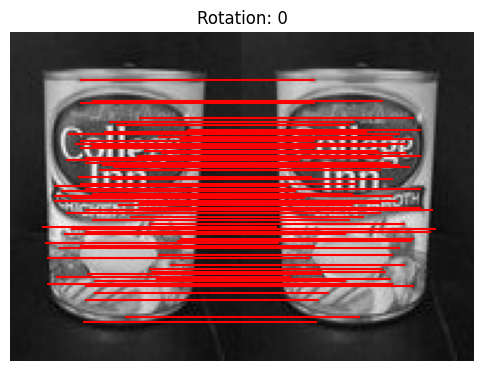

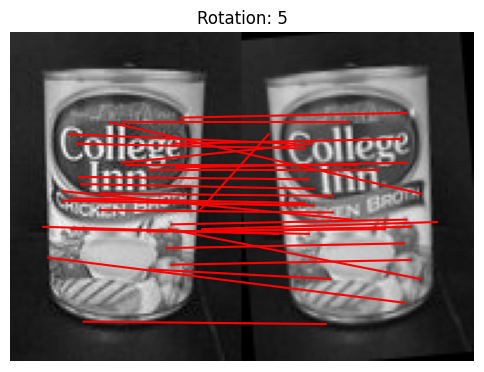

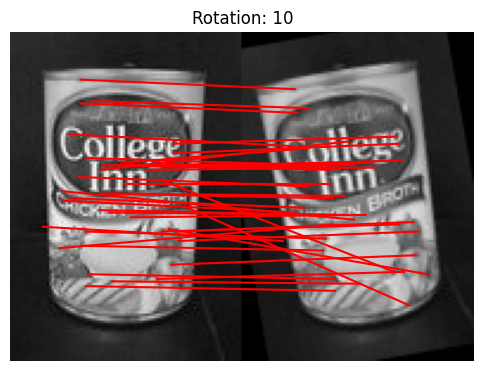

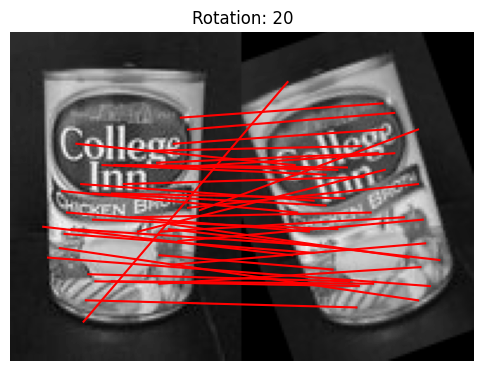

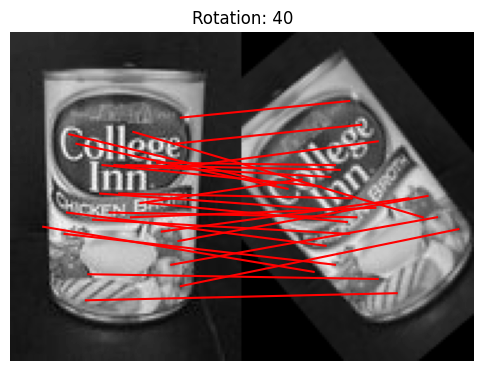

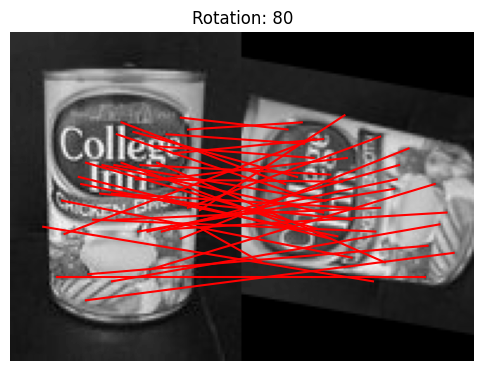

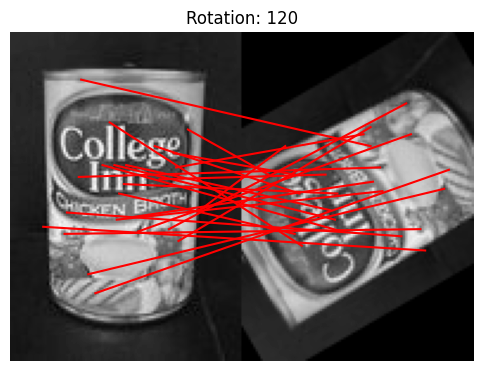

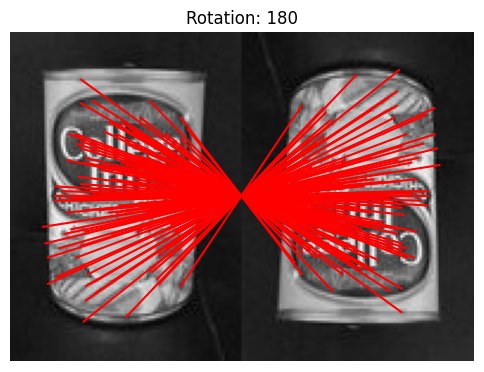

In [15]:
imgCan = io.imread("imgs/can/can_model.jpg")
imgCan = color.rgb2gray(imgCan)
parameter_span = [0, 5, 10, 20, 40, 80, 120, 180]
parameter_name = "Rotation"


def rotation(angle, img):
    rows, cols = can_img.shape
    M = cv2.getRotationMatrix2D(((cols - 1) / 2.0, (rows - 1) / 2.0), angle, 1)
    return M, cv2.warpAffine(img, M, (cols, rows))


compareAfterTransformation(
    imgCan, parameter_span, parameter_name, rotation, matchImagesrBRIEF
)


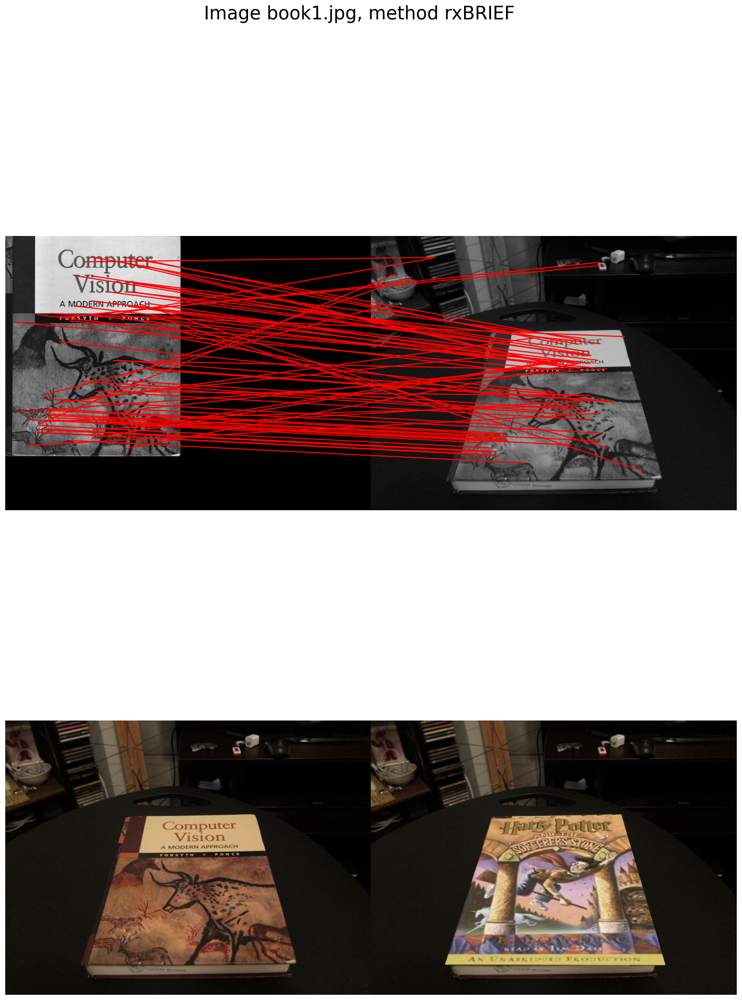

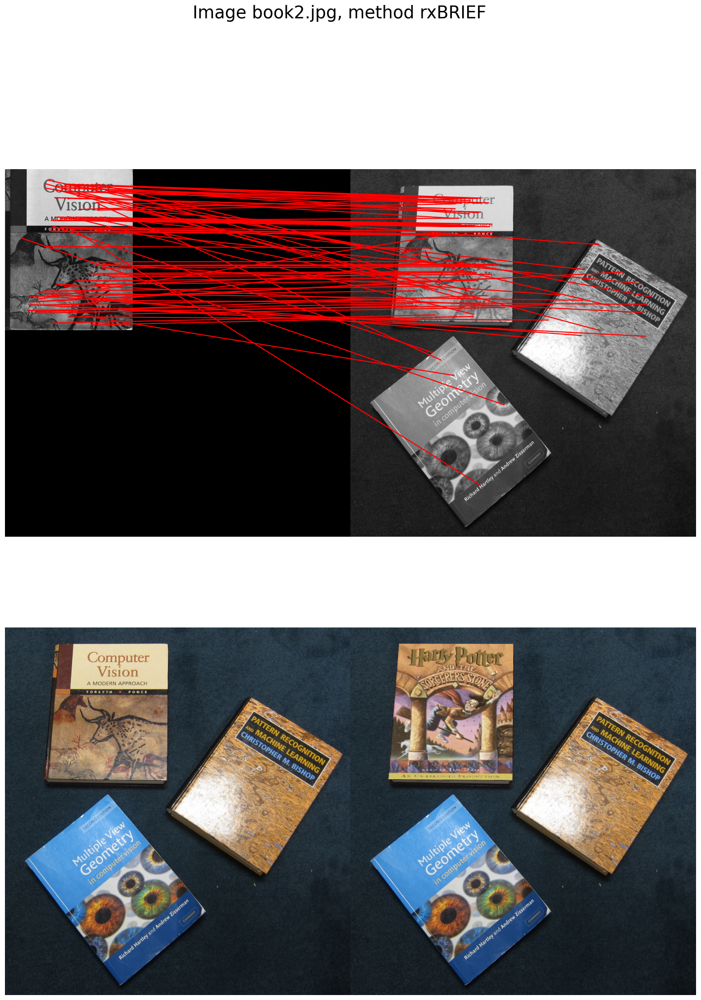

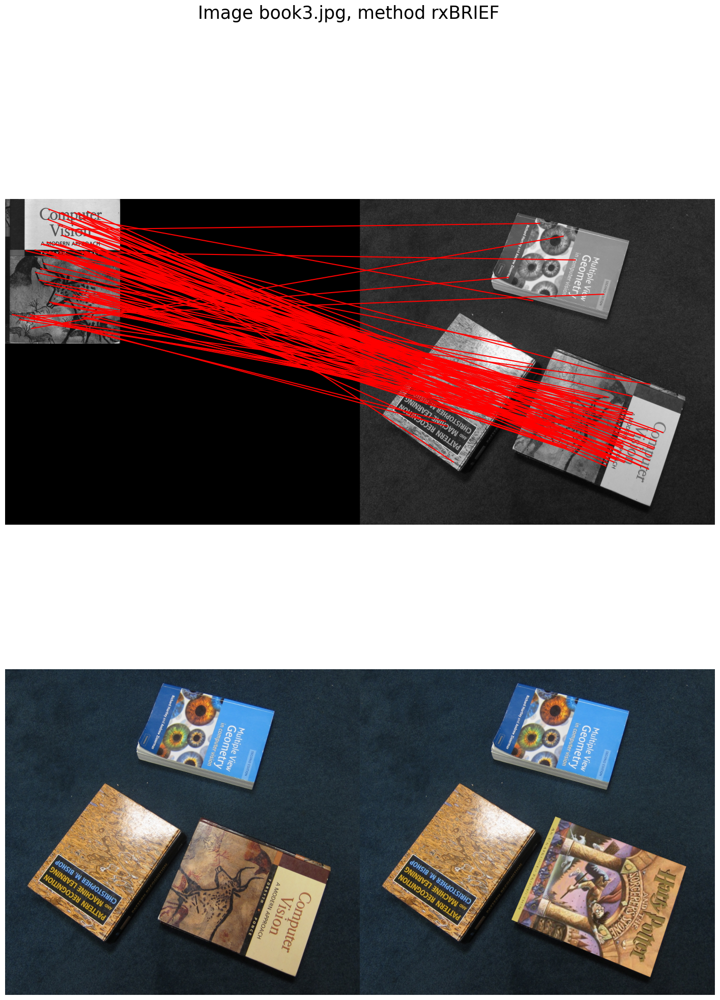

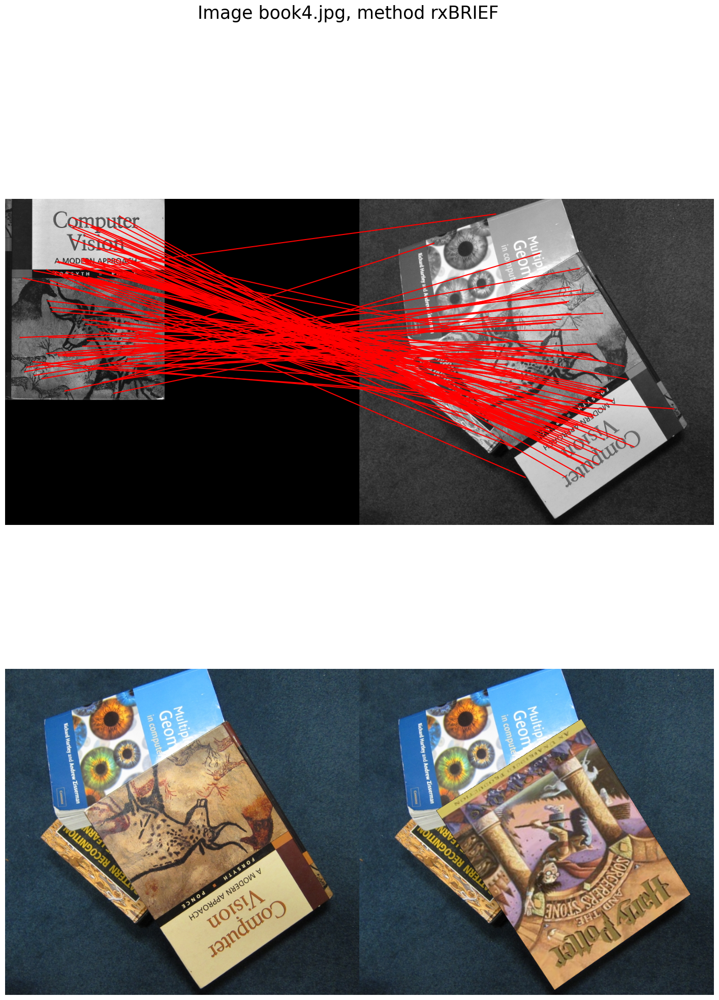

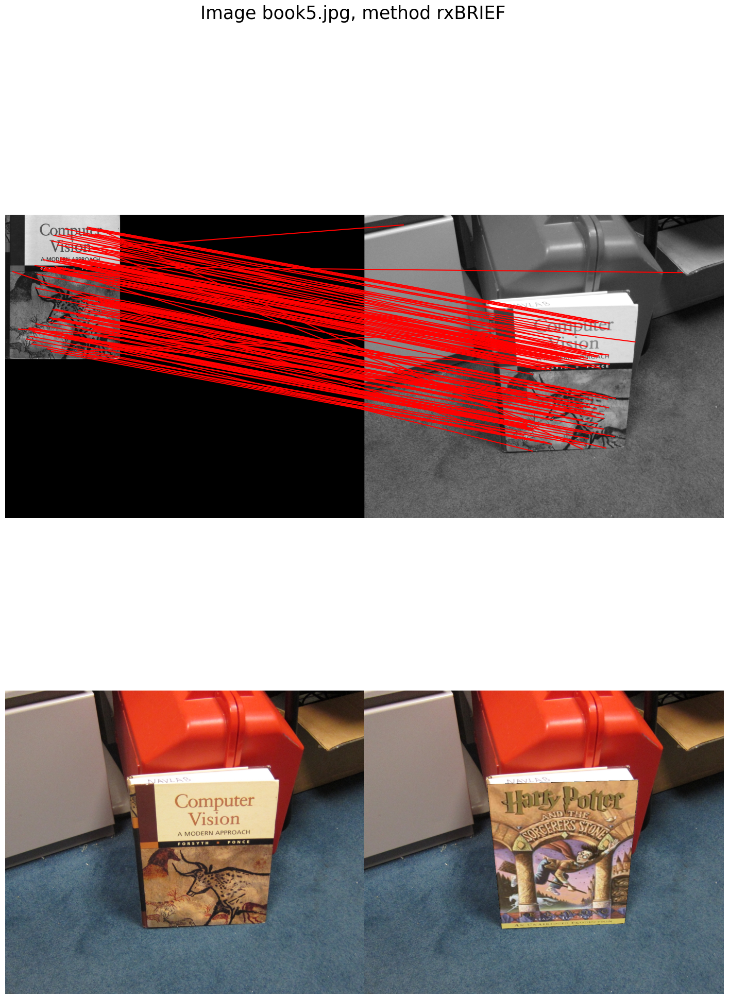

In [16]:
for bookFile in paths:
    fig = plt.figure(figsize=(18, 24))

    gs = fig.add_gridspec(2, 2)
    ax1 = fig.add_subplot(gs[0, :])
    ax2 = fig.add_subplot(gs[1, 0])
    ax3 = fig.add_subplot(gs[1, 1])
    fig.suptitle(f"Image {bookFile}, method rBRIEF",size=25)
    fig.subplots_adjust(wspace=0, hspace=0)
    ax1.set_axis_off()
    ax1.set_aspect("equal")
    ax2.set_axis_off()
    ax2.set_aspect("equal")
    ax3.set_axis_off()
    ax3.set_aspect("equal")
    bookPath = os.path.join("imgs/book", bookFile)
    imgBook2 = cv2.imread(bookPath, cv2.IMREAD_GRAYSCALE)
    imgBook2Color = cv2.imread(bookPath, cv2.IMREAD_COLOR)
    imgBook2Color = cv2.cvtColor(imgBook2Color, cv2.COLOR_BGR2RGB)
    rows, cols = imgBook2.shape
    locBRIEFBook1, locBRIEFBook2, matches = matchImagesrBRIEF(imgBook1, imgBook2)
    locs1 = locBRIEFBook1[:2, matches[:, 0]].T
    locs2 = locBRIEFBook2[:2, matches[:, 1]].T
    M, _ = cv2.findHomography(locs1, locs2, cv2.RANSAC)

    transformedBook = cv2.warpPerspective(imgHP, M, (cols, rows))
    mask = transformedBook != 0
    newImg = imgBook2Color * np.logical_not(mask) + transformedBook * mask
    ax2.imshow(imgBook2Color, cmap="gray", interpolation=None)
    ax3.imshow(newImg, cmap="gray", interpolation=None)
    feature.plot_matches(
        ax1,
        imgBook1,
        imgBook2,
        locBRIEFBook1[[1, 0]].T,
        locBRIEFBook2[[1, 0]].T,
        matches,
        only_matches=True,
        matches_color="red",
    )
